# Audio Signal Processing with Transfer Functions

This tests the ability to process audio signals using the linear systems tools avaiable in the python control systems library.  The background on audio i/o in Python comes from http://musicinformationretrieval.com/ipython_audio.html.

### Install Audio Libraries

In [12]:
#!pip install sounddevice
#!pip install librosa
#!pip install control
#!pip install slycot

### Initialization

In [13]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import control

# audio libraries
from IPython.display import Audio
import librosa

# the control library generates a warning that can be ignored
import warnings
warnings.filterwarnings('ignore')

## Import Ambient Noise

In [14]:
u, fs = librosa.load('ambient_noise.m4a')    # returns numpy array of samples, u, and sample rate fs
T = len(u)/fs
print('len = ',len(u),' rate = ',fs, ' T = ', T,' sec')

t = np.linspace(0,T, int(T*fs),endpoint=False)

len =  4816830  rate =  22050  T =  218.45034013605442  sec


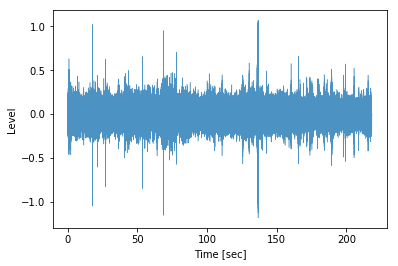

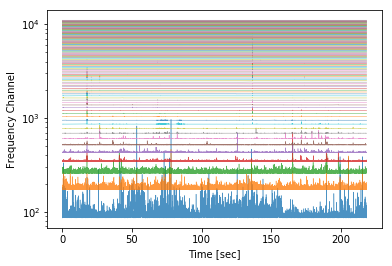

In [16]:
from scipy import signal

def specgram(x,fs):
    f, tt, Sxx = signal.spectrogram(x, fs)
    for k in range(1,int(len(f))):
        plt.semilogy(tt,f[k]+500000*abs(Sxx[k,:]),lw=0.5,alpha=0.8)
        plt.ylabel('Frequency Channel')
        plt.xlabel('Time [sec]')

specgram(u,fs)

## Passive Noise Cancellation

### Headphone Transfer Function to Ambient Noise

The following transfer function describes the transfer of ambient sound through the headphone gear to internal sound chamber. This is the sound that we'd like to block.

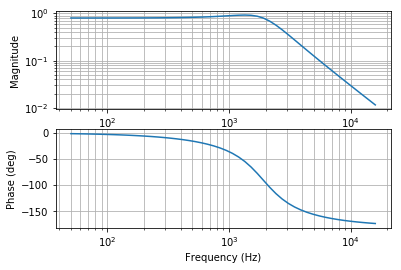

In [17]:
# noise transfer function
tau = 1/12000      # fairly low cutoff frequency
zeta = 0.5       # damping factor
Gd = control.tf([0.8],[tau*tau, 2*zeta*tau, 1])

w = np.logspace(2.5,5)

control.bode(Gd,w,Hz=True);

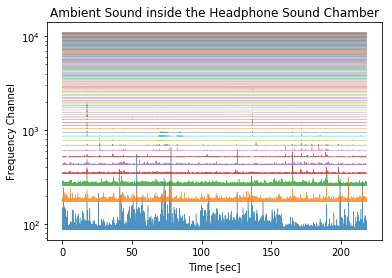

In [18]:
t,y,tmp = control.forced_response(Gd,t,u)
specgram(y,fs)
plt.title('Ambient Sound inside the Headphone Sound Chamber')
Audio(y,rate=fs)

## Active Noise Cancellation

Feedforward active noise cancellation works by sensing the ambient noise with an external microphone, then creating an 'anti-sound' to broadcast into the headphone sound chamber. The key is to match, as closely as possible, the transfer function of the microphone/filter/speaker pathway to the transfer function of the passive pathway, $G_d(s)$.

Denoting the microphone/speaker transfer function $G_m(s)$, and $G_f(s)$ the transfer function for active cancellation, the goal is to make

$$\| G_f(s)G_m(s) - G_d(s)\|$$

as small as possible.

### Microphone and Speaker Transfer function

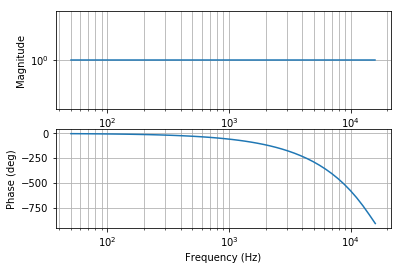

In [19]:
# microphone transfer function
tdelay = 0.000160  # 160 microsecond delay
num,den = control.pade(tdelay,9)
Gm = control.tf(num,den)

control.bode(Gm,w,Hz=True);

### Ambient Noise Cancellation

The microphone/speaker transfer function $G_m(s)$ is a pure time-delay for which there exists no causal inverse $G_m^{-1}(s)$. Here we'll use

$$G_f = G_d(s)$$

so that the eror

\begin{align*}
G_e(s) & = G_d(s) - G_d(s)G_m(s) \\
& = G_d(s)(I - G_m(s))
\end{align*}

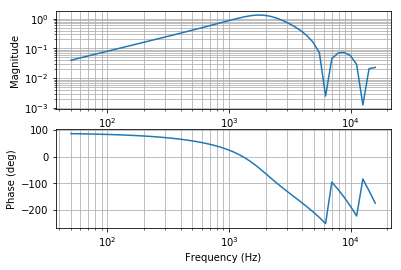

In [20]:
Ge = Gd - Gd*Gm
control.bode(Ge,w,Hz=True);

## Headphone Simulation

### Load Music File

### Music and Ambient Noise

### Music with Passive Noise Reduction

### Music with Passive and Active Noise Reduction